# Market Analysis of Top Three Cities in The United States of America


In [206]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.stats import linregress
import seaborn as sns
import hvplot.pandas
import plotly.express as px

from sklearn.model_selection import train_test_split

from sklearn import metrics

from sklearn.linear_model import LinearRegression
%matplotlib inline


# Impor the OpenWeatherMap API key
# from api_keys import 



### Dataset:  resting_heart_rate.csv

In [207]:
# Create a file path
df=pd.read_csv("Resources/Realtor_Data.csv")

# Read in the data. 
df

,status,bed,bath,acre_lot,city,state,zip_code,house_size,prev_sold_date,price
0,for_sale,3.0,2.0,0.12,Adjuntas,Puerto Rico,601.0,920.0,NaN,105000.0
1,for_sale,4.0,2.0,0.08,Adjuntas,Puerto Rico,601.0,1527.0,NaN,80000.0
2,for_sale,2.0,1.0,0.15,Juana Diaz,Puerto Rico,795.0,748.0,NaN,67000.0
3,for_sale,4.0,2.0,0.10,Ponce,Puerto Rico,731.0,1800.0,NaN,145000.0
4,for_sale,6.0,2.0,0.05,Mayaguez,Puerto Rico,680.0,NaN,NaN,65000.0
...,...,...,...,...,...,...,...,...,...,...
1048570,for_sale,5.0,4.0,0.14,Hollis,New York,11423.0,2574.0,11/8/2004,1175000.0
1048571,for_sale,7.0,4.0,0.09,Hollis,New York,11423.0,NaN,12/15/2021,1349000.0
1048572,for_sale,5.0,3.0,0.09,Hollis,New York,11423.0,NaN,7/18/2018,925000.0
1048573,for_sale,4.0,3.0,0.13,Hollis,New York,11423.0,NaN,3/12/2003,1350000.0


---

In [208]:
df['prev_sold_encoded'] = df['prev_sold_date'].map(lambda x: 'Yes' if pd.notna(x) else 'No')
df

,status,bed,bath,acre_lot,city,state,zip_code,house_size,prev_sold_date,price,prev_sold_encoded
0,for_sale,3.0,2.0,0.12,Adjuntas,Puerto Rico,601.0,920.0,NaN,105000.0,No
1,for_sale,4.0,2.0,0.08,Adjuntas,Puerto Rico,601.0,1527.0,NaN,80000.0,No
2,for_sale,2.0,1.0,0.15,Juana Diaz,Puerto Rico,795.0,748.0,NaN,67000.0,No
3,for_sale,4.0,2.0,0.10,Ponce,Puerto Rico,731.0,1800.0,NaN,145000.0,No
4,for_sale,6.0,2.0,0.05,Mayaguez,Puerto Rico,680.0,NaN,NaN,65000.0,No
...,...,...,...,...,...,...,...,...,...,...,...
1048570,for_sale,5.0,4.0,0.14,Hollis,New York,11423.0,2574.0,11/8/2004,1175000.0,Yes
1048571,for_sale,7.0,4.0,0.09,Hollis,New York,11423.0,NaN,12/15/2021,1349000.0,Yes
1048572,for_sale,5.0,3.0,0.09,Hollis,New York,11423.0,NaN,7/18/2018,925000.0,Yes
1048573,for_sale,4.0,3.0,0.13,Hollis,New York,11423.0,NaN,3/12/2003,1350000.0,Yes


In [209]:
df.duplicated().sum()

926465

In [210]:

df.drop_duplicates()

,status,bed,bath,acre_lot,city,state,zip_code,house_size,prev_sold_date,price,prev_sold_encoded
0,for_sale,3.0,2.0,0.12,Adjuntas,Puerto Rico,601.0,920.0,NaN,105000.0,No
1,for_sale,4.0,2.0,0.08,Adjuntas,Puerto Rico,601.0,1527.0,NaN,80000.0,No
2,for_sale,2.0,1.0,0.15,Juana Diaz,Puerto Rico,795.0,748.0,NaN,67000.0,No
3,for_sale,4.0,2.0,0.10,Ponce,Puerto Rico,731.0,1800.0,NaN,145000.0,No
4,for_sale,6.0,2.0,0.05,Mayaguez,Puerto Rico,680.0,NaN,NaN,65000.0,No
...,...,...,...,...,...,...,...,...,...,...,...
1048521,for_sale,4.0,3.0,0.09,Rosedale,New York,11422.0,NaN,3/18/2002,849990.0,Yes
1048539,for_sale,6.0,5.0,0.09,Rosedale,New York,11422.0,2315.0,4/9/2021,1279000.0,Yes
1048543,for_sale,1.0,1.0,NaN,Hollis,New York,11423.0,NaN,2/11/2021,190000.0,Yes
1048558,for_sale,1.0,1.0,NaN,Hollis,New York,11423.0,NaN,NaN,179000.0,No


In [211]:
fig = px.box(df, x="price",y="state",width=700,points=False)
fig.update_layout(xaxis_range=[0,2*10**6])
fig.show()

In [212]:
total_missing = df.isna().sum()*100/len(df)
print('Percentage Missing Value %')
total_missing

Percentage Missing Value %


status                0.000000
bed                  13.717664
bath                 11.778747
acre_lot             30.441027
city                  0.007343
state                 0.000000
zip_code              0.019836
house_size           32.623704
prev_sold_date       49.398946
price                 0.006866
prev_sold_encoded     0.000000
dtype: float64

In [213]:
df.fillna(0,inplace=True)

In [214]:
new_york_df = df[df['city'] == 'New York']
new_york_df

,status,bed,bath,acre_lot,city,state,zip_code,house_size,prev_sold_date,price,prev_sold_encoded
465089,for_sale,2.0,2.0,0.0,New York,New York,10021.0,0.0,0,1185000.0,No
465111,for_sale,12.0,14.0,0.0,New York,New York,10014.0,8528.0,0,29995000.0,No
465513,for_sale,2.0,2.0,0.0,New York,New York,10022.0,1425.0,0,895000.0,No
465515,for_sale,1.0,2.0,0.0,New York,New York,10005.0,1166.0,1/10/2014,985000.0,Yes
465516,for_sale,1.0,1.0,0.0,New York,New York,10065.0,761.0,8/18/2020,810000.0,Yes
...,...,...,...,...,...,...,...,...,...,...,...
1047710,for_sale,1.0,1.0,0.0,New York,New York,10010.0,750.0,6/2/2016,1300000.0,Yes
1047729,for_sale,1.0,1.0,0.0,New York,New York,10025.0,0.0,10/31/2014,625000.0,Yes
1047753,for_sale,3.0,4.0,0.0,New York,New York,10016.0,2880.0,5/19/2017,5750000.0,Yes
1047842,for_sale,2.0,1.0,0.0,New York,New York,11368.0,0.0,1/10/2018,182000.0,Yes


In [215]:
clean_df= new_york_df.describe().round(2)
clean_df

,bed,bath,acre_lot,zip_code,house_size,price
count,52742.00,52742.00,52742.00,52742.00,52742.00,5.274200e+04
mean,1.92,2.05,0.00,10134.47,947.69,2.616878e+06
std,1.60,1.54,0.01,344.30,1582.60,4.566627e+06
min,0.00,0.00,0.00,0.00,0.00,0.000000e+00
25%,1.00,1.00,0.00,10016.00,0.00,6.985000e+05
50%,2.00,2.00,0.00,10023.00,638.00,1.280000e+06
75%,3.00,3.00,0.00,10036.00,1318.00,2.750000e+06
max,40.00,45.00,0.36,11697.00,61839.00,1.350000e+08


In [216]:
clean_df.corr()

,bed,bath,acre_lot,zip_code,house_size,price
bed,1.000000,1.000000,1.000000,0.960445,0.582387,-0.156262
bath,1.000000,1.000000,1.000000,0.960455,0.582463,-0.156170
acre_lot,1.000000,1.000000,1.000000,0.960363,0.581805,-0.156968
zip_code,0.960445,0.960455,0.960363,1.000000,0.642844,-0.049328
house_size,0.582387,0.582463,0.581805,0.642844,1.000000,0.711886
price,-0.156262,-0.156170,-0.156968,-0.049328,0.711886,1.000000


<Axes: >

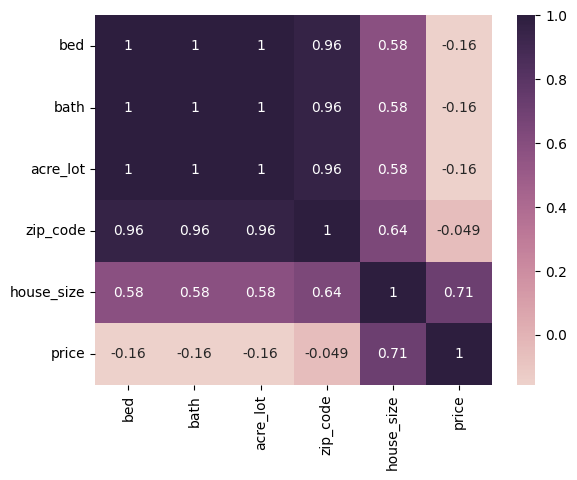

In [217]:
sns.heatmap(clean_df.corr(), annot=True,cmap=sns.cubehelix_palette(as_cmap=True))

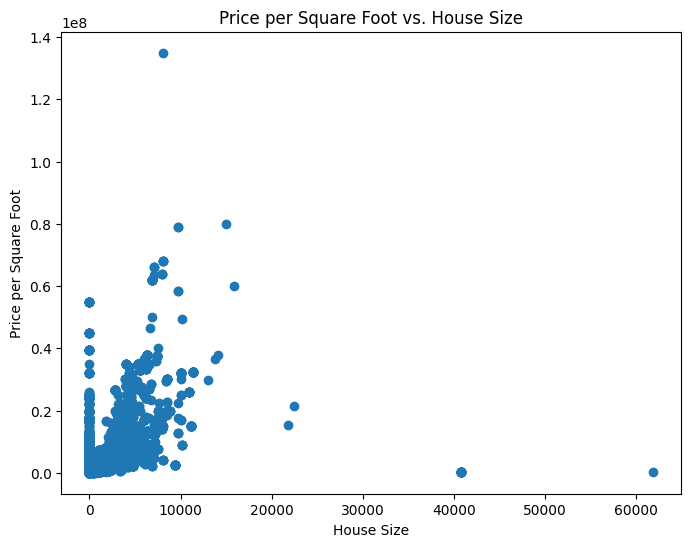

In [218]:
plt.figure(figsize=(8, 6))
plt.scatter(new_york_df['house_size'], new_york_df['price'])
plt.xlabel('House Size')
plt.ylabel('Price per Square Foot')
plt.title('Price per Square Foot vs. House Size')
plt.show()

## Question

### Create the Scatter Plots 

#### 

---

### Compute Linear Regression for Each Relationship
